<a href="https://colab.research.google.com/github/uttar07/VSL-/blob/main/notebook/train_yolov12_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Check GPU availability

**NOTE:** **YOLOv12 leverages FlashAttention to speed up attention-based computations, but this feature requires an Nvidia GPU built on the Ampere architecture or newer—for example, GPUs like the RTX 3090, RTX 3080, or even the Nvidia L4 meet this requirement.**

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [25]:
!nvidia-smi

Sat Oct 11 18:31:44 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   34C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [26]:
import os
HOME = os.getcwd()
print(HOME)

/content


### Install dependencies

**NOTE:** Currently, YOLOv12 does not have its own PyPI package, so we install it directly from GitHub while also adding roboflow (to conveniently pull datasets from the Roboflow Universe), supervision (to visualize inference results and benchmark the model’s performance), and flash-attn (to accelerate attention-based computations via optimized CUDA kernels).

In [3]:
!pip install -q git+https://github.com/sunsmarterjie/yolov12.git roboflow supervision flash-attn

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 118.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.8/89.8 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.2/207.2 kB 18.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 76.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 117.1 MB/s eta 0:00:00


In [4]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="wt619JarRfICyjoamgtz")
project = rf.workspace("prism-zhxxq").project("people-4wxxx")
version = project.version(1)
dataset = version.download("yolov12")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to people-1 in yolov12:: 100%|██████████| 1644/1644 [00:00<00:00, 4731.90it/s]


In [5]:
!ls /content


people-1  sample_data


In [8]:
from ultralytics import YOLO

model = YOLO('yolov12s.yaml')

results = model.train(data=f'/content/people-1/data.yaml', epochs=100,imgsz=640,batch=8,name="people-1")

New https://pypi.org/project/ultralytics/8.3.209 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov12s.yaml, data=/content/people-1/data.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=people-12, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, sav

train: Scanning /content/people-1/train/labels... 571 images, 0 backgrounds, 0 corrupt: 100%|██████████| 571/571 [00:00<00:00, 2370.67it/s]

train: New cache created: /content/people-1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression
val: Scanning /content/people-1/valid/labels... 163 images, 0 backgrounds, 0 corrupt: 100%|██████████| 163/163 [00:00<00:00, 1838.40it/s]

val: New cache created: /content/people-1/valid/labels.cache


Plotting labels to runs/detect/people-12/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 121 weight(decay=0.0), 128 weight(decay=0.0005), 127 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/people-12
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.75G      4.441      3.613      3.912         32        640: 100%|██████████| 72/72 [00:43<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:09<00:00,  1.10it/s]

                   all        163        594   0.000613     0.0505   0.000399   7.13e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      3.71G      3.121        2.8      3.184         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.14it/s]

                   all        163        594     0.0865     0.0236     0.0108    0.00337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      3.77G      2.651       2.45      2.817          9        640: 100%|██████████| 72/72 [00:20<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.36it/s]

                   all        163        594     0.0374      0.131     0.0211    0.00728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100       3.7G      2.438      2.241      2.668         19        640: 100%|██████████| 72/72 [00:20<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.56it/s]

                   all        163        594      0.172      0.299      0.123     0.0452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      3.71G      2.329      2.089      2.552         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.89it/s]


                   all        163        594      0.261      0.566      0.298      0.121

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       3.7G      2.293      1.954      2.486         26        640: 100%|██████████| 72/72 [00:20<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.17it/s]

                   all        163        594      0.335      0.473      0.291      0.122



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      3.71G      2.147      1.874      2.395         18        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.26it/s]

                   all        163        594      0.467       0.64      0.496      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100       3.7G      2.068      1.782      2.322          9        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.24it/s]

                   all        163        594      0.496      0.369      0.407      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100       3.7G      1.962      1.707       2.22         20        640: 100%|██████████| 72/72 [00:21<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.24it/s]

                   all        163        594      0.573      0.695      0.636      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100       3.7G      1.955       1.67      2.213         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.23it/s]

                   all        163        594      0.689      0.578      0.687      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      3.69G      1.874      1.617      2.127         30        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.25it/s]

                   all        163        594      0.687      0.721       0.78       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      3.71G      1.765      1.575      2.046         22        640: 100%|██████████| 72/72 [00:21<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.32it/s]

                   all        163        594      0.623      0.662      0.716      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100       3.7G      1.727      1.453      1.976         28        640: 100%|██████████| 72/72 [00:21<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.29it/s]

                   all        163        594      0.736       0.63       0.76      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       3.7G      1.676      1.406      1.942         11        640: 100%|██████████| 72/72 [00:20<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.63it/s]

                   all        163        594      0.695       0.81      0.814      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100       3.7G      1.613      1.368      1.875         14        640: 100%|██████████| 72/72 [00:20<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.48it/s]

                   all        163        594      0.681      0.596      0.693      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       3.7G      1.591       1.34      1.849         21        640: 100%|██████████| 72/72 [00:20<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.93it/s]

                   all        163        594      0.796      0.767      0.853      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      3.69G      1.519      1.254      1.777         27        640: 100%|██████████| 72/72 [00:20<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.35it/s]

                   all        163        594      0.705       0.84      0.799      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       3.7G      1.479      1.249      1.751         21        640: 100%|██████████| 72/72 [00:20<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.20it/s]

                   all        163        594      0.803      0.803      0.882       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       3.7G      1.469      1.216      1.721         20        640: 100%|██████████| 72/72 [00:21<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.27it/s]

                   all        163        594      0.705      0.882      0.856      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100       3.7G      1.487      1.211      1.733         36        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.32it/s]

                   all        163        594      0.747      0.845      0.875       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       3.7G      1.419      1.177      1.673         25        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.28it/s]

                   all        163        594      0.802      0.854      0.908      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100       3.7G      1.402      1.133      1.639         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.25it/s]

                   all        163        594      0.789      0.829      0.886      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       3.7G      1.364      1.108      1.625         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.25it/s]

                   all        163        594      0.873      0.771      0.897      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      3.69G      1.353      1.095      1.592         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.51it/s]

                   all        163        594      0.814      0.842      0.896      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       3.7G      1.318      1.084      1.556         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.39it/s]

                   all        163        594      0.795      0.876      0.917      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       3.7G      1.311      1.066      1.558         20        640: 100%|██████████| 72/72 [00:20<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.77it/s]

                   all        163        594      0.845      0.759       0.87      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100       3.7G      1.274      1.025      1.516         32        640: 100%|██████████| 72/72 [00:20<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.30it/s]

                   all        163        594      0.788      0.899      0.897      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100       3.7G      1.299      1.042      1.514         12        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.29it/s]

                   all        163        594      0.792      0.887      0.904       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100       3.7G      1.225     0.9764      1.466         39        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.28it/s]

                   all        163        594      0.794      0.852      0.908       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       3.7G      1.249      0.995      1.488         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.32it/s]

                   all        163        594      0.759      0.879      0.866      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      3.69G      1.238     0.9767      1.468         20        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.32it/s]

                   all        163        594      0.748      0.895      0.818      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100       3.7G      1.224     0.9544       1.45         26        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.30it/s]

                   all        163        594      0.801      0.893      0.902      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      3.71G      1.206     0.9567      1.444         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.31it/s]

                   all        163        594      0.842      0.882      0.937      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       3.7G      1.224     0.9556      1.461         21        640: 100%|██████████| 72/72 [00:20<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.54it/s]

                   all        163        594      0.804      0.903      0.891       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100       3.7G      1.177     0.9614      1.418         17        640: 100%|██████████| 72/72 [00:20<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.65it/s]

                   all        163        594      0.776      0.896      0.861      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       3.7G      1.174     0.9428      1.406         18        640: 100%|██████████| 72/72 [00:20<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.40it/s]

                   all        163        594      0.845      0.877      0.911      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.71G      1.177     0.9438      1.415         13        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.29it/s]

                   all        163        594      0.857      0.884      0.939      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       3.7G       1.16     0.9156      1.409         21        640: 100%|██████████| 72/72 [00:21<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.25it/s]

                   all        163        594      0.843      0.892       0.93      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100       3.7G      1.141     0.9136       1.38         19        640: 100%|██████████| 72/72 [00:20<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.36it/s]

                   all        163        594      0.843      0.886       0.94      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100       3.7G      1.127     0.8845      1.359         22        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.31it/s]

                   all        163        594      0.856      0.879      0.931      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       3.7G       1.14     0.8922      1.366         20        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.26it/s]

                   all        163        594      0.713      0.946      0.862      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       3.7G      1.094     0.8645       1.33         13        640: 100%|██████████| 72/72 [00:20<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.54it/s]

                   all        163        594      0.807      0.892       0.91      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100       3.7G      1.126     0.8762      1.365         14        640: 100%|██████████| 72/72 [00:20<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.66it/s]

                   all        163        594      0.881      0.862       0.94      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       3.7G      1.089     0.8777      1.347         16        640: 100%|██████████| 72/72 [00:20<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.30it/s]

                   all        163        594      0.845      0.896      0.928      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100       3.7G      1.079     0.8431      1.328         12        640: 100%|██████████| 72/72 [00:20<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.36it/s]

                   all        163        594      0.826      0.929      0.925      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      3.69G      1.095     0.8543      1.334         22        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.33it/s]

                   all        163        594      0.837      0.902      0.923      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100       3.7G      1.074     0.8386      1.309         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.33it/s]

                   all        163        594       0.87       0.88      0.925      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100       3.7G       1.06     0.8206       1.31         26        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.31it/s]

                   all        163        594      0.812      0.919      0.907      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100       3.7G       1.06     0.8335      1.321         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.25it/s]

                   all        163        594       0.79      0.941      0.925      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       3.7G      1.048     0.8176        1.3         17        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.83it/s]

                   all        163        594      0.886       0.88      0.943      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100       3.7G       1.02     0.7927      1.268         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.42it/s]

                   all        163        594      0.889      0.869      0.943      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100       3.7G      1.047     0.8053      1.283         26        640: 100%|██████████| 72/72 [00:20<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.93it/s]

                   all        163        594      0.857      0.907      0.945      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100       3.7G      1.014     0.7955      1.288         24        640: 100%|██████████| 72/72 [00:20<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.25it/s]

                   all        163        594      0.881      0.884       0.95      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       3.7G     0.9984     0.7843      1.259         20        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.38it/s]

                   all        163        594      0.828      0.922      0.921      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      3.71G      1.006     0.7878      1.283         21        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.38it/s]

                   all        163        594      0.886      0.884      0.951      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100       3.7G     0.9715     0.7553      1.238         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.32it/s]

                   all        163        594      0.883      0.893      0.952       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100       3.7G     0.9734     0.7596      1.245         20        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.35it/s]

                   all        163        594      0.887      0.897      0.951      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       3.7G     0.9867     0.7707      1.264         20        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.15it/s]

                   all        163        594      0.849      0.914       0.94      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100       3.7G     0.9903     0.7606      1.251          9        640: 100%|██████████| 72/72 [00:20<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.43it/s]

                   all        163        594      0.815      0.929       0.91      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       3.7G     0.9727     0.7786      1.254          8        640: 100%|██████████| 72/72 [00:20<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.84it/s]

                   all        163        594      0.814      0.921      0.927      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100       3.7G     0.9892     0.7742      1.261         19        640: 100%|██████████| 72/72 [00:20<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.38it/s]

                   all        163        594      0.855      0.889      0.945      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       3.7G     0.9451     0.7365       1.22         24        640: 100%|██████████| 72/72 [00:20<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.38it/s]

                   all        163        594       0.88      0.918      0.948      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100       3.7G     0.9545     0.7491      1.233         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.29it/s]

                   all        163        594      0.875      0.894       0.95      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.71G     0.9872     0.7759      1.248         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.30it/s]

                   all        163        594      0.883      0.886      0.956      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.69G     0.9455     0.7432      1.223         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.35it/s]

                   all        163        594      0.893      0.884      0.953      0.768



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100       3.7G     0.9411     0.7419      1.237         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.34it/s]

                   all        163        594      0.896      0.877      0.953      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100       3.7G     0.9246     0.7229      1.219         23        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.92it/s]

                   all        163        594      0.853      0.931      0.948      0.763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100       3.7G     0.9304     0.7282      1.222         11        640: 100%|██████████| 72/72 [00:20<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.48it/s]

                   all        163        594      0.894      0.892      0.951       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100       3.7G     0.9478     0.7482      1.227          7        640: 100%|██████████| 72/72 [00:20<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.02it/s]

                   all        163        594      0.859      0.915      0.939      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       3.7G     0.9175     0.7222      1.201         25        640: 100%|██████████| 72/72 [00:20<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.27it/s]

                   all        163        594      0.863      0.912      0.948      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100       3.7G     0.9226      0.705      1.212         24        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.33it/s]

                   all        163        594      0.854      0.933      0.934      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100       3.7G      0.934     0.7244      1.216         12        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.30it/s]

                   all        163        594      0.863      0.914      0.943      0.764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100       3.7G     0.8917     0.7022      1.196         26        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.25it/s]

                   all        163        594      0.813      0.937      0.917      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       3.7G     0.9016     0.7073      1.193         22        640: 100%|██████████| 72/72 [00:20<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.22it/s]

                   all        163        594      0.864       0.92      0.941      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100       3.7G     0.9167     0.7206      1.202         30        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.67it/s]

                   all        163        594      0.914       0.88      0.956      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100       3.7G     0.8918     0.7019      1.189         12        640: 100%|██████████| 72/72 [00:20<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.64it/s]

                   all        163        594      0.917      0.884      0.962      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100       3.7G     0.9061     0.6888      1.197         22        640: 100%|██████████| 72/72 [00:20<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.31it/s]

                   all        163        594      0.885      0.917       0.95      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100       3.7G     0.8946     0.6718      1.189         13        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.27it/s]

                   all        163        594      0.861       0.92      0.938      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      3.71G     0.8577     0.6678      1.162         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.29it/s]

                   all        163        594      0.872      0.926      0.958      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       3.7G     0.8684     0.6822       1.18         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.33it/s]

                   all        163        594      0.909      0.912      0.959       0.78



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100       3.7G     0.8573      0.667       1.17         27        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.36it/s]

                   all        163        594      0.884      0.914       0.96      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100       3.7G     0.8594     0.6803      1.175         23        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.36it/s]

                   all        163        594      0.878      0.924      0.952       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       3.7G     0.8684      0.665      1.174         26        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.95it/s]

                   all        163        594      0.851      0.942      0.944      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       3.7G     0.8638     0.6572      1.173         12        640: 100%|██████████| 72/72 [00:20<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.35it/s]

                   all        163        594      0.913      0.896      0.956        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      3.69G     0.8446     0.6519      1.153         24        640: 100%|██████████| 72/72 [00:20<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.08it/s]

                   all        163        594      0.877      0.926      0.952      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100       3.7G     0.8525      0.651      1.168         20        640: 100%|██████████| 72/72 [00:20<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.34it/s]

                   all        163        594      0.896      0.907      0.958      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100       3.7G     0.8504     0.6472      1.165         33        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.33it/s]

                   all        163        594      0.924      0.876      0.956      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100       3.7G     0.8338     0.6523      1.159          8        640: 100%|██████████| 72/72 [00:20<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.38it/s]

                   all        163        594      0.894      0.902      0.946      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      3.69G     0.8374     0.6371      1.163         19        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.36it/s]

                   all        163        594       0.87       0.92       0.95      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       3.7G     0.8433     0.6517      1.153         18        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.32it/s]

                   all        163        594      0.885      0.923      0.956      0.803


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100       3.7G     0.6612     0.5381      1.011          9        640: 100%|██████████| 72/72 [00:21<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.29it/s]

                   all        163        594      0.878      0.934      0.957      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100       3.7G     0.6384     0.5172     0.9878         14        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.05it/s]

                   all        163        594      0.911      0.901       0.96      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100       3.7G      0.638     0.5162     0.9834         11        640: 100%|██████████| 72/72 [00:20<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.31it/s]

                   all        163        594      0.901      0.919      0.965      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       3.7G     0.6197      0.509     0.9744          8        640: 100%|██████████| 72/72 [00:20<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.01it/s]

                   all        163        594      0.891      0.923       0.96      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100       3.7G     0.6101     0.5005     0.9713          9        640: 100%|██████████| 72/72 [00:20<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.40it/s]

                   all        163        594      0.885      0.934      0.963      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100       3.7G     0.6184     0.4986     0.9713          7        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.30it/s]

                   all        163        594      0.898      0.909      0.957      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       3.7G     0.6154     0.5012     0.9787          6        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.31it/s]

                   all        163        594      0.884      0.938      0.963      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100       3.7G     0.6187     0.5031     0.9726         13        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.30it/s]

                   all        163        594      0.886      0.928      0.964       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100       3.7G     0.6177     0.4972     0.9696         10        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  5.33it/s]

                   all        163        594      0.898      0.916      0.964      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100       3.7G     0.5983     0.4841     0.9642         13        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  4.99it/s]

                   all        163        594      0.894      0.918      0.965      0.836



100 epochs completed in 0.679 hours.
Optimizer stripped from runs/detect/people-12/weights/last.pt, 18.6MB
Optimizer stripped from runs/detect/people-12/weights/best.pt, 18.6MB

Validating runs/detect/people-12/weights/best.pt...
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,074,595 parameters, 0 gradients, 19.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03<00:00,  3.22it/s]


                   all        163        594      0.894      0.919      0.965      0.835
Speed: 0.4ms preprocess, 10.4ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/people-12


In [9]:
model.val()

Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,074,595 parameters, 0 gradients, 19.3 GFLOPs


val: Scanning /content/people-1/valid/labels.cache... 163 images, 0 backgrounds, 0 corrupt: 100%|██████████| 163/163 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 21/21 [00:03<00:00,  5.31it/s]


                   all        163        594      0.894      0.919      0.965      0.835
Speed: 0.5ms preprocess, 16.5ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/people-122


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c2dfb147c20>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [10]:
model.predict(source="/content/people-1/valid/images", save=True,conf=0.5)


image 1/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0005_jpg.rf.d1057825789ef1c122812c308846e58c.jpg: 640x640 7 Persons, 22.9ms
image 2/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0008_jpg.rf.19587952c0c152b4a343ad75b56a709a.jpg: 640x640 8 Persons, 25.2ms
image 3/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0015_jpg.rf.9b30a2c13b7172e55965b371dbd5cd20.jpg: 640x640 9 Persons, 23.0ms
image 4/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0021_jpg.rf.b12f2fd8002350209fed8e50c63bc915.jpg: 640x640 3 Persons, 26.5ms
image 5/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0024_jpg.rf.1e40c1d8d7a7e97e5cb7ecb2bed4d503.jpg: 640x640 2 Persons, 26.2ms
image 6/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0026_jpg.rf.6332d4a2279e87eac624c4c6b9d4060a.jpg: 640x640 1 Person, 22.4ms
image 7/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0027_jpg.rf.d61d282825c547a3932da20dffcb418c.jpg: 640x640 1 Person, 23.3ms
image 8/163 /content/people-1/valid/images/yt-YzcawvDGe4Y-0033_

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Person'}
 obb: None
 orig_img: array([[[243, 226, 213],
         [244, 228, 215],
         [246, 230, 217],
         ...,
         [ 76,  84,  83],
         [ 76,  84,  83],
         [ 76,  84,  83]],
 
        [[244, 227, 214],
         [245, 229, 216],
         [245, 232, 218],
         ...,
         [ 76,  84,  83],
         [ 76,  84,  83],
         [ 76,  84,  83]],
 
        [[245, 229, 216],
         [246, 230, 217],
         [247, 234, 220],
         ...,
         [ 76,  84,  83],
         [ 76,  84,  83],
         [ 76,  84,  83]],
 
        ...,
 
        [[113, 117, 118],
         [116, 120, 121],
         [119, 123, 124],
         ...,
         [112, 122, 122],
         [111, 121, 121],
         [110, 120, 120]],
 
        [[114, 118, 119],
         [116, 120, 121],
         [119, 123, 124],
         ...,
         [112, 122

In [11]:
!pip install Ipython

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 71.5 MB/s eta 0:00:00


In [12]:
!ls /content/runs/detect

people-1  people-12  people-122  people-123  pothole_yolov12


In [19]:
!ls /content/runs/detect/people-123

yt-YzcawvDGe4Y-0005_jpg.rf.d1057825789ef1c122812c308846e58c.jpg
yt-YzcawvDGe4Y-0008_jpg.rf.19587952c0c152b4a343ad75b56a709a.jpg
yt-YzcawvDGe4Y-0015_jpg.rf.9b30a2c13b7172e55965b371dbd5cd20.jpg
yt-YzcawvDGe4Y-0021_jpg.rf.b12f2fd8002350209fed8e50c63bc915.jpg
yt-YzcawvDGe4Y-0024_jpg.rf.1e40c1d8d7a7e97e5cb7ecb2bed4d503.jpg
yt-YzcawvDGe4Y-0026_jpg.rf.6332d4a2279e87eac624c4c6b9d4060a.jpg
yt-YzcawvDGe4Y-0027_jpg.rf.d61d282825c547a3932da20dffcb418c.jpg
yt-YzcawvDGe4Y-0033_jpg.rf.9b7aa7397761de46d5ab51ba801fb155.jpg
yt-YzcawvDGe4Y-0036_jpg.rf.bc406817c5dcf51f42845dc7f741bdd1.jpg
yt-YzcawvDGe4Y-0040_jpg.rf.d49597a7a6e9dba5d5fa28656b798603.jpg
yt-YzcawvDGe4Y-0047_jpg.rf.d859c5867ce0e11a874819c167127db1.jpg
yt-YzcawvDGe4Y-0052_jpg.rf.946393a3fe1a760f0351ef9ce7d4d376.jpg
yt-YzcawvDGe4Y-0056_jpg.rf.0ef1fcaa421fd5122d27827ebee8fffc.jpg
yt-YzcawvDGe4Y-0063_jpg.rf.c47688631b8029f31b0725a76deefbd5.jpg
yt-YzcawvDGe4Y-0067_jpg.rf.1ddc2e9b42762718c445dd9ac176904b.jpg
yt-YzcawvDGe4Y-0068_jpg.rf.fe5aa786523ea

In [25]:
from IPython.display import Image, display
import glob
for image_path in sorted(glob.glob('/content/runs/detect/people-123 /*.jpg'))[:10]:
  display(Image(filename=image_path))

In [26]:
!pip install Ipython

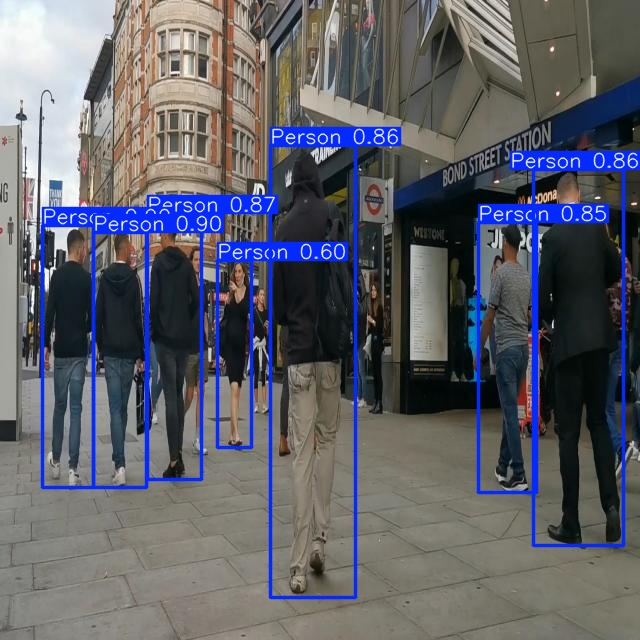

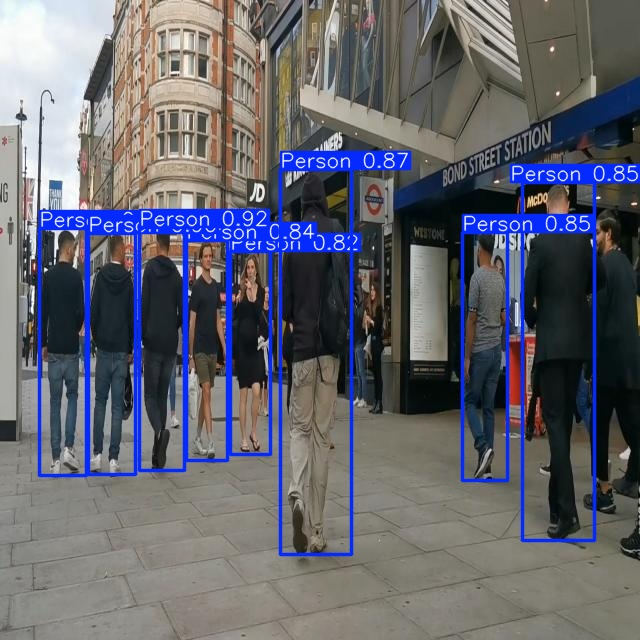

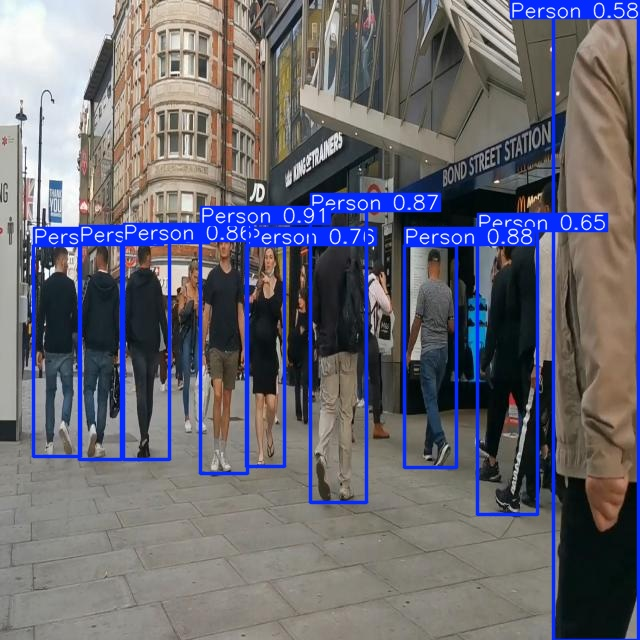

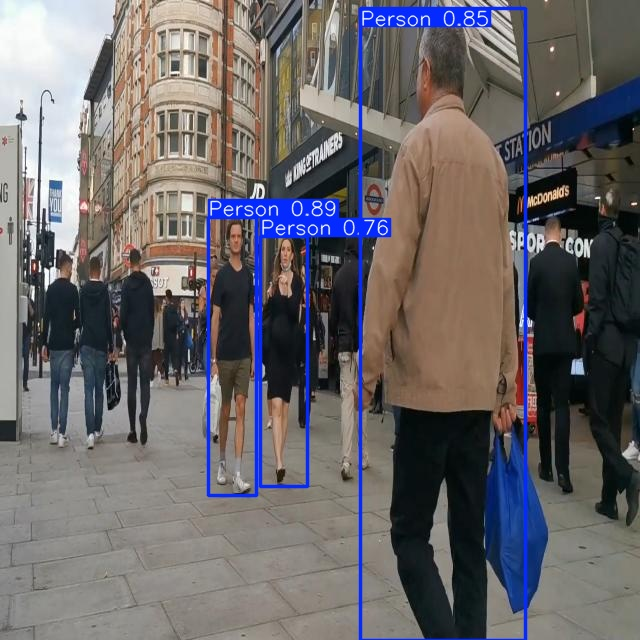

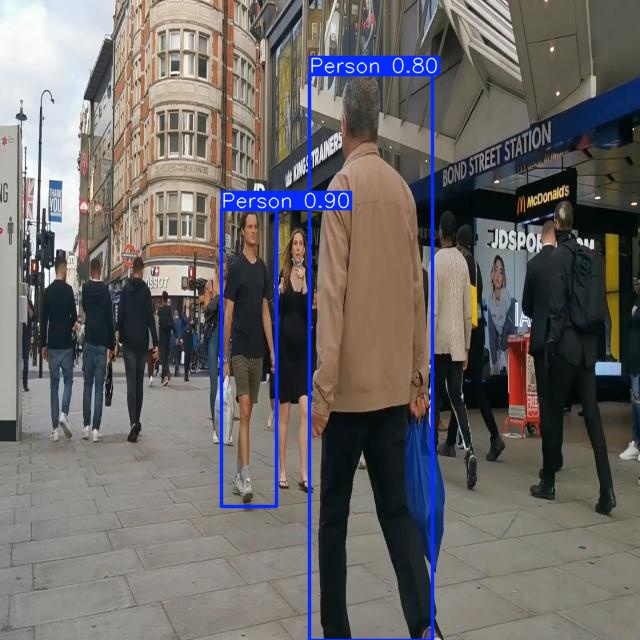

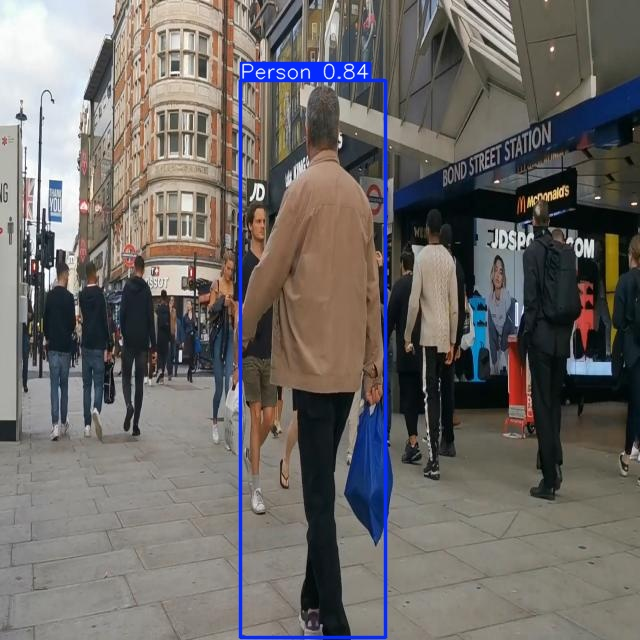

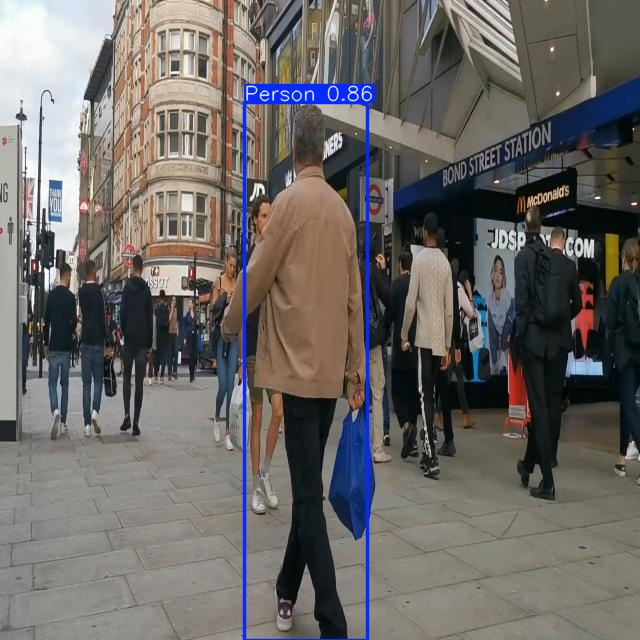

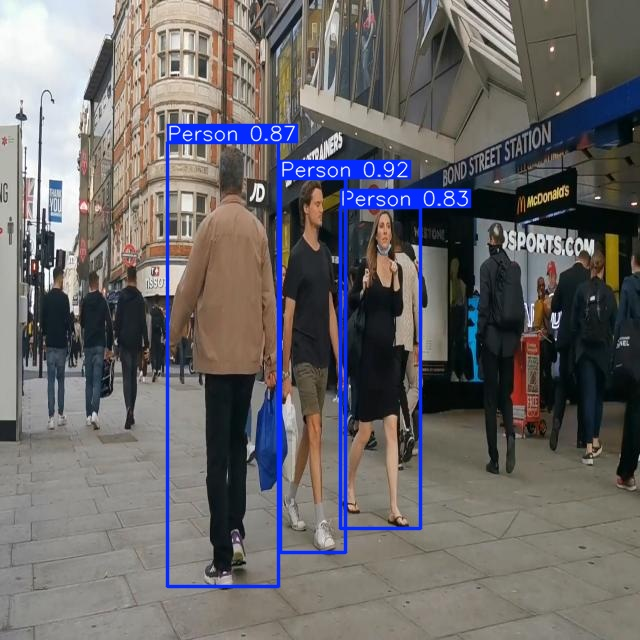

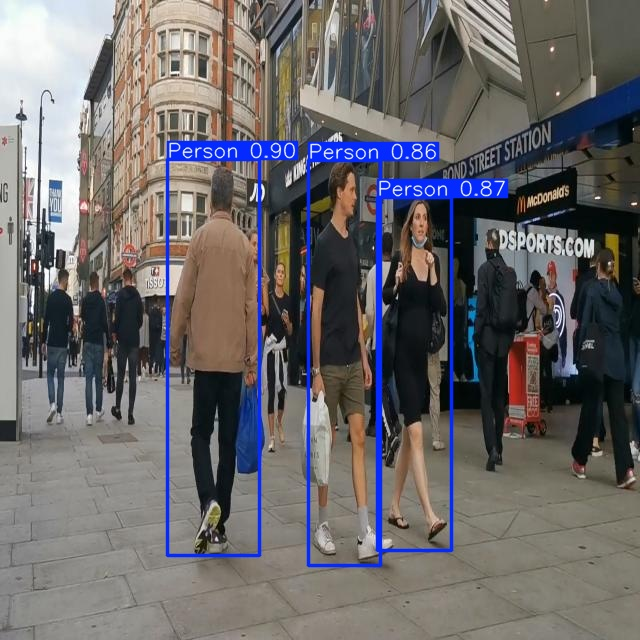

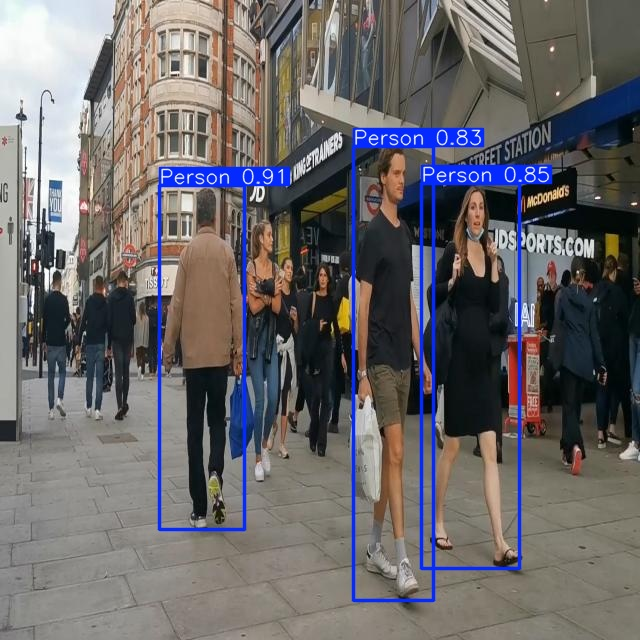

In [28]:
from IPython.display import Image, display
import glob
for image_path in sorted(glob.glob('/content/runs/detect/people-123/*.jpg'))[:10]:
  display(Image(filename=image_path))

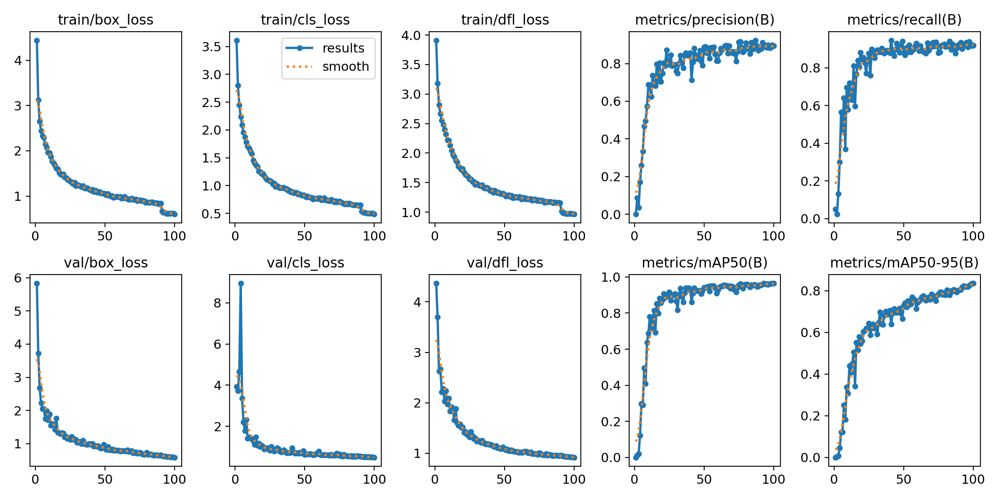

In [30]:
from IPython.display import Image, display
display(Image(filename='/content/runs/detect/people-12/results.png'))

In [3]:
!yolo task=detect mode=val model=/content/runs/detect/train3/weights/best.pt data=/content/people-1/data.yaml

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 954, in entrypoint
    model = YOLO(model, task=task)
            ^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/models/yolo/model.py", line 23, in __init__
    super().__init__(model=model, task=task, verbose=verbose)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 148, in __init__
    self._load(model, task=task)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 291, in _load
    self.model, self.ckpt = attempt_load_one_weight(weights)
                            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/nn/tasks.py", line 9

In [4]:
!ls /content/runs/detect/

people-1  people-12  people-122  people-123  pothole_yolov12


In [5]:
!ls /content/runs/detect/people-123

yt-YzcawvDGe4Y-0005_jpg.rf.d1057825789ef1c122812c308846e58c.jpg
yt-YzcawvDGe4Y-0008_jpg.rf.19587952c0c152b4a343ad75b56a709a.jpg
yt-YzcawvDGe4Y-0015_jpg.rf.9b30a2c13b7172e55965b371dbd5cd20.jpg
yt-YzcawvDGe4Y-0021_jpg.rf.b12f2fd8002350209fed8e50c63bc915.jpg
yt-YzcawvDGe4Y-0024_jpg.rf.1e40c1d8d7a7e97e5cb7ecb2bed4d503.jpg
yt-YzcawvDGe4Y-0026_jpg.rf.6332d4a2279e87eac624c4c6b9d4060a.jpg
yt-YzcawvDGe4Y-0027_jpg.rf.d61d282825c547a3932da20dffcb418c.jpg
yt-YzcawvDGe4Y-0033_jpg.rf.9b7aa7397761de46d5ab51ba801fb155.jpg
yt-YzcawvDGe4Y-0036_jpg.rf.bc406817c5dcf51f42845dc7f741bdd1.jpg
yt-YzcawvDGe4Y-0040_jpg.rf.d49597a7a6e9dba5d5fa28656b798603.jpg
yt-YzcawvDGe4Y-0047_jpg.rf.d859c5867ce0e11a874819c167127db1.jpg
yt-YzcawvDGe4Y-0052_jpg.rf.946393a3fe1a760f0351ef9ce7d4d376.jpg
yt-YzcawvDGe4Y-0056_jpg.rf.0ef1fcaa421fd5122d27827ebee8fffc.jpg
yt-YzcawvDGe4Y-0063_jpg.rf.c47688631b8029f31b0725a76deefbd5.jpg
yt-YzcawvDGe4Y-0067_jpg.rf.1ddc2e9b42762718c445dd9ac176904b.jpg
yt-YzcawvDGe4Y-0068_jpg.rf.fe5aa786523ea

In [7]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/people-12/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

Saving 1.mp4 to 1 (2).mp4
Uploaded video: 1 (2).mp4
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,074,595 parameters, 0 gradients, 19.3 GFLOPs

video 1/1 (frame 1/596) /content/1 (2).mp4: 384x640 (no detections), 59.2ms
video 1/1 (frame 2/596) /content/1 (2).mp4: 384x640 (no detections), 14.2ms
video 1/1 (frame 3/596) /content/1 (2).mp4: 384x640 (no detections), 14.5ms
video 1/1 (frame 4/596) /content/1 (2).mp4: 384x640 (no detections), 14.2ms
video 1/1 (frame 5/596) /content/1 (2).mp4: 384x640 (no detections), 14.6ms
video 1/1 (frame 6/596) /content/1 (2).mp4: 384x640 (no detections), 14.7ms
video 1/1 (frame 7/596) /content/1 (2).mp4: 384x640 (no detections), 14.0ms
video 1/1 (frame 8/596) /content/1 (2).mp4: 384x640 (no detections), 14.5ms
video 1/1 (frame 9/596) /content/1 (2).mp4: 384x640 (no detections), 14.0ms
vide

In [8]:
from IPython.display import HTML
from base64 import b64encode
import glob
import os

# Step 1: Find the latest predict folder
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

# Step 2: Get the output video file
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))
if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 3: Display the video in Colab
    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

No output video found.


In [9]:
!yolo task=detect mode=predict \
     model=/content/runs/detect/train3/weights/best.pt \
     source="/content/1.mp4" \
     save=True \
     save_video=True

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 903, in entrypoint
    check_dict_alignment(full_args_dict, overrides)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 485, in check_dict_alignment
    raise SyntaxError(string + CLI_HELP_MSG) from e
SyntaxError: 'save_video' is not a valid YOLO argument. Similar arguments are i.e. ['save_period=-1', 'save_hybrid=False', 'save_json=False'].

    Arguments received: ['yolo', 'task=detect', 'mode=predict', 'model=/content/runs/detect/train3/weights/best.pt', 'source=/content/1.mp4', 'save=True', 'save_video=True']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of {'segme

In [11]:
!ls -l /content/runs/detect/predict

total 97308
-rw-r--r-- 1 root root 99639510 Oct 11 17:47 '1 (2).avi'


In [13]:
# 1️⃣ Convert AVI to MP4
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

!ffmpeg -y -i "{output_folder}/1 (2).avi" \
-c:v libx264 -pix_fmt yuv420p "{output_folder}/annotated_video.mp4"

# 2️⃣ Play the converted MP4 inline
from IPython.display import HTML
from base64 import b64encode

video_path = f"{output_folder}/annotated_video.mp4"
mp4 = open(video_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=640 controls>
      <source src="{data_url}" type="video/mp4">
</video>
""")

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [15]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/people-12/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

Saving 2.mp4 to 2.mp4
Uploaded video: 2.mp4
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,074,595 parameters, 0 gradients, 19.3 GFLOPs

video 1/1 (frame 1/474) /content/2.mp4: 384x640 1 Person, 58.3ms
video 1/1 (frame 2/474) /content/2.mp4: 384x640 1 Person, 14.9ms
video 1/1 (frame 3/474) /content/2.mp4: 384x640 (no detections), 16.9ms
video 1/1 (frame 4/474) /content/2.mp4: 384x640 (no detections), 14.8ms
video 1/1 (frame 5/474) /content/2.mp4: 384x640 (no detections), 14.4ms
video 1/1 (frame 6/474) /content/2.mp4: 384x640 (no detections), 14.5ms
video 1/1 (frame 7/474) /content/2.mp4: 384x640 1 Person, 14.4ms
video 1/1 (frame 8/474) /content/2.mp4: 384x640 1 Person, 14.1ms
video 1/1 (frame 9/474) /content/2.mp4: 384x640 2 Persons, 14.9ms
video 1/1 (frame 10/474) /content/2.mp4: 384x640 (no detections), 14.4ms
video 1/1

In [16]:
from IPython.display import HTML
from base64 import b64encode
import glob
import os

# Step 1: Find the latest predict folder
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

# Step 2: Get the output video file
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))
if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 3: Display the video in Colab
    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

No output video found.


In [17]:
!yolo task=detect mode=predict \
     model=/content/runs/detect/train3/weights/best.pt \
     source="/content/2.mp4" \
     save=True \
     save_video=True

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 903, in entrypoint
    check_dict_alignment(full_args_dict, overrides)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 485, in check_dict_alignment
    raise SyntaxError(string + CLI_HELP_MSG) from e
SyntaxError: 'save_video' is not a valid YOLO argument. Similar arguments are i.e. ['save_period=-1', 'save_hybrid=False', 'save_json=False'].

    Arguments received: ['yolo', 'task=detect', 'mode=predict', 'model=/content/runs/detect/train3/weights/best.pt', 'source=/content/2.mp4', 'save=True', 'save_video=True']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of {'pose'

In [21]:
# 1️⃣ Convert AVI to MP4
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict2*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

!ffmpeg -y -i "{output_folder}/2.avi" \
-c:v libx264 -pix_fmt yuv420p "{output_folder}/annotated_video.mp4"

# 2️⃣ Play the converted MP4 inline
from IPython.display import HTML
from base64 import b64encode

video_path = f"{output_folder}/annotated_video.mp4"
mp4 = open(video_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=640 controls>
      <source src="{data_url}" type="video/mp4">
</video>
""")

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [23]:
# ---------------------------------------------
# YOLO Pothole Project Backup Script for Colab
# ---------------------------------------------

from google.colab import drive
import os
import shutil
import datetime

# 1️⃣ Mount Google Drive
drive.mount('/content/drive')

# 2️⃣ Define paths
project_name = "people-1"
timestamp = datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
src_project_folder = "/content/people-1"  # Your current project folder
dest_drive_folder = f"/content/drive/MyDrive/{project_name}_{timestamp}"

# 3️⃣ Copy project folder to Drive
if os.path.exists(src_project_folder):
    shutil.copytree(src_project_folder, dest_drive_folder)
    print(f"✅ Project folder backed up to: {dest_drive_folder}")
else:
    print(f"❌ Source project folder not found: {src_project_folder}")

# 4️⃣ Backup YOLO trained weights
weights_src = "/content/runs/detect/train/weights/best.pt"
weights_dest = os.path.join(dest_drive_folder, "best.pt")
if os.path.exists(weights_src):
    shutil.copy2(weights_src, weights_dest)
    print(f"✅ Trained weights backed up to: {weights_dest}")
else:
    print(f"❌ Weights not found: {weights_src}")

# 5️⃣ Backup prediction results
predict_folder = "/content/runs/detect/predict2"  # Change if different
predict_dest = os.path.join(dest_drive_folder, "predict_results")
if os.path.exists(predict_folder):
    shutil.copytree(predict_folder, predict_dest)
    print(f"✅ Prediction results backed up to: {predict_dest}")
else:
    print(f"❌ Prediction results not found: {predict_folder}")

# 6️⃣ Optional: Backup notebook file
# Replace with your actual notebook filename
notebook_file = "/content/people-1.ipynb"
if os.path.exists(notebook_file):
    shutil.copy2(notebook_file, dest_drive_folder)
    print(f"✅ Notebook backed up to: {dest_drive_folder}")
else:
    print(f"❌ Notebook not found: {notebook_file}")

print("🎉 Backup complete! Everything is saved to Google Drive.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Project folder backed up to: /content/drive/MyDrive/people-1_2025-10-11_18-21-32
❌ Weights not found: /content/runs/detect/train/weights/best.pt
✅ Prediction results backed up to: /content/drive/MyDrive/people-1_2025-10-11_18-21-32/predict_results
❌ Notebook not found: /content/people-1.ipynb
🎉 Backup complete! Everything is saved to Google Drive.


In [24]:
import os, shutil, glob

# === 1️⃣ Set Google Drive destination folder ===
dest_drive_folder = "/content/drive/MyDrive/YOLO_Backup"
os.makedirs(dest_drive_folder, exist_ok=True)

# === 2️⃣ Find the latest training folder (contains weights/best.pt) ===
train_folders = sorted(glob.glob('/content/runs/detect/*'), key=os.path.getmtime)
latest_train_folder = None

for folder in reversed(train_folders):
    if os.path.exists(os.path.join(folder, 'weights', 'best.pt')):
        latest_train_folder = folder
        break

if latest_train_folder:
    weights_src = os.path.join(latest_train_folder, 'weights', 'best.pt')
    weights_dest = os.path.join(dest_drive_folder, 'best.pt')
    shutil.copy2(weights_src, weights_dest)
    print(f"✅ Found model in: {latest_train_folder}")
    print(f"✅ Trained weights backed up to: {weights_dest}")
else:
    print("❌ No trained model with best.pt found in /runs/detect/")

# === 3️⃣ Find latest prediction folder ===
predict_folders = [f for f in train_folders if 'predict' in f]
if predict_folders:
    latest_predict_folder = max(predict_folders, key=os.path.getmtime)
    predict_dest = os.path.join(dest_drive_folder, 'predict_results')
    shutil.copytree(latest_predict_folder, predict_dest, dirs_exist_ok=True)
    print(f"✅ Prediction results backed up from: {latest_predict_folder}")
    print(f"✅ Saved to: {predict_dest}")
else:
    print("❌ No prediction folder found.")

# === 4️⃣ Backup the current notebook (if any) ===
notebooks = glob.glob('/content/*.ipynb')
if notebooks:
    latest_notebook = max(notebooks, key=os.path.getmtime)
    shutil.copy2(latest_notebook, dest_drive_folder)
    print(f"✅ Notebook backed up: {os.path.basename(latest_notebook)}")
else:
    print("❌ No notebook found in /content/")



✅ Found model in: /content/runs/detect/people-12
✅ Trained weights backed up to: /content/drive/MyDrive/YOLO_Backup/best.pt
✅ Prediction results backed up from: /content/runs/detect/predict2
✅ Saved to: /content/drive/MyDrive/YOLO_Backup/predict_results
❌ No notebook found in /content/


In [27]:
!mkdir -p /content/backup_people
!cp -r /content/runs/detect/train* /content/backup_people/
!cp /content/runs/detect/train*/weights/best.pt /content/backup_people/
print("✅ People detection model safely backed up!")


cp: cannot stat '/content/runs/detect/train*': No such file or directory
cp: cannot stat '/content/runs/detect/train*/weights/best.pt': No such file or directory
✅ People detection model safely backed up!


In [30]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="wt619JarRfICyjoamgtz")
project = rf.workspace("custom-yolo-orjlu").project("vehicle-detection-bnyxm")
version = project.version(1)
dataset = version.download("yolov12")


loading Roboflow workspace...
loading Roboflow project...


In [31]:
!ls /content

'1 (1).mp4'	 runs
'1 (2).mp4'	 sample_data
 1.mp4		 Vehicle-Detection-1
 2.mp4		'WhatsApp Video 2025-10-11 at 11.35.19 PM.mp4'
 backup_people	 yolov12n.pt
 drive		 yolov8n.pt
 people-1


In [3]:
from ultralytics import YOLO

model = YOLO('yolov12s.yaml')

results = model.train(data=f'/content/Vehicle-Detection-1/data.yaml', epochs=100,imgsz=640,batch=8,name="Vehicle-Detection-1")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


FileNotFoundError: 'yolov12s.yaml' does not exist

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 55.4 MB/s eta 0:00:00


In [4]:
from ultralytics import YOLO

model = YOLO('yolov12s.yaml')

results = model.train(data=f'/content/Vehicle-Detection-1/data.yaml', epochs=100,imgsz=640,batch=8,name="Vehicle-Detection-1")

FileNotFoundError: 'yolov12s.yaml' does not exist

In [5]:
!git clone https://github.com/sunsmarterjie/yolov12.git

Cloning into 'yolov12'...
remote: Enumerating objects: 1163, done.
remote: Counting objects: 100% (483/483), done.
remote: Compressing objects: 100% (186/186), done.
remote: Total 1163 (delta 325), reused 296 (delta 296), pack-reused 680 (from 2)
Receiving objects: 100% (1163/1163), 1.81 MiB | 20.11 MiB/s, done.
Resolving deltas: 100% (581/581), done.


In [7]:
from ultralytics import YOLO

model = YOLO('/content/yolov12/yolov12s.yaml')

results = model.train(data=f'/content/Vehicle-Detection-1/data.yaml', epochs=100,imgsz=640,batch=8,name="Vehicle-Detection-1")

FileNotFoundError: '/content/yolov12/yolov12s.yaml' does not exist

In [ ]:
!find /content/yolov12 -name "yolov12s.yaml"

In [9]:
!ls /content/yolov12/models

ls: cannot access '/content/yolov12/models': No such file or directory


In [8]:
!ls /content/yolov12

app.py	docker	  LICENSE  mkdocs.yml	   README.md	     tests
assets	examples  logs	   pyproject.toml  requirements.txt  ultralytics


In [10]:
from ultralytics import YOLO

model = YOLO('yolov12s.yaml')

results = model.train(data=f'/content/Vehicle-Detection-1/data.yaml', epochs=100,imgsz=640,batch=8,name="Vehicle-Detection-1")

FileNotFoundError: 'yolov12s.yaml' does not exist